In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
df=pd.read_csv("flight_train.csv")
df.head()

,MEMBER_NO,FFP_DATE,FIRST_FLIGHT_DATE,GENDER,FFP_TIER,WORK_CITY,WORK_PROVINCE,WORK_COUNTRY,AGE,LOAD_TIME,...,SUM_YR_2,SEG_KM_SUM,LAST_FLIGHT_DATE,LAST_TO_END,AVG_INTERVAL,MAX_INTERVAL,EXCHANGE_COUNT,avg_discount,Points_Sum,Point_NotFlight
0,54993,11/2/2006,12/24/2008,Male,6,.,beijing,CN,31.0,3/31/2014,...,234188.0,580717,3/31/2014,1,3.483254,18,34,0.961639,619760,50
1,28065,2/19/2007,8/3/2007,Male,6,NaN,beijing,CN,42.0,3/31/2014,...,167434.0,293678,3/25/2014,7,5.194245,17,29,1.252314,415768,33
2,55106,2/1/2007,8/30/2007,Male,6,.,beijing,CN,40.0,3/31/2014,...,164982.0,283712,3/21/2014,11,5.298507,18,20,1.254676,406361,26
3,21189,8/22/2008,8/23/2008,Male,5,Los Angeles,CA,US,64.0,3/31/2014,...,125500.0,281336,12/26/2013,97,27.863636,73,11,1.090870,372204,12
4,39546,4/10/2009,4/15/2009,Male,6,guiyang,guizhou,CN,48.0,3/31/2014,...,130702.0,309928,3/27/2014,5,4.788079,47,27,0.970658,338813,39


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 55000 entries, 0 to 54999
Data columns (total 23 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   MEMBER_NO          55000 non-null  int64  
 1   FFP_DATE           55000 non-null  object 
 2   FIRST_FLIGHT_DATE  55000 non-null  object 
 3   GENDER             54997 non-null  object 
 4   FFP_TIER           55000 non-null  int64  
 5   WORK_CITY          53034 non-null  object 
 6   WORK_PROVINCE      52216 non-null  object 
 7   WORK_COUNTRY       54980 non-null  object 
 8   AGE                54658 non-null  float64
 9   LOAD_TIME          55000 non-null  object 
 10  FLIGHT_COUNT       55000 non-null  int64  
 11  BP_SUM             55000 non-null  int64  
 12  SUM_YR_1           54738 non-null  float64
 13  SUM_YR_2           54937 non-null  float64
 14  SEG_KM_SUM         55000 non-null  int64  
 15  LAST_FLIGHT_DATE   55000 non-null  object 
 16  LAST_TO_END        550

In [4]:
df.dropna(inplace=True)#Drop rows that contain missing values and upadating df

In [5]:
df.isna().sum()

MEMBER_NO            0
FFP_DATE             0
FIRST_FLIGHT_DATE    0
GENDER               0
FFP_TIER             0
WORK_CITY            0
WORK_PROVINCE        0
WORK_COUNTRY         0
AGE                  0
LOAD_TIME            0
FLIGHT_COUNT         0
BP_SUM               0
SUM_YR_1             0
SUM_YR_2             0
SEG_KM_SUM           0
LAST_FLIGHT_DATE     0
LAST_TO_END          0
AVG_INTERVAL         0
MAX_INTERVAL         0
EXCHANGE_COUNT       0
avg_discount         0
Points_Sum           0
Point_NotFlight      0
dtype: int64

In [6]:
df.duplicated().sum()

0

In [7]:
#cleaning of data
crit_1 = (df['SUM_YR_1']!=0)|(df['SUM_YR_2']!=0)#  fare prices are not zero
crit_2 = (df['avg_discount']==0)&(df['SEG_KM_SUM']==0)#average discount and total mileage are 0

In [8]:
df[(crit_1|crit_2)]

,MEMBER_NO,FFP_DATE,FIRST_FLIGHT_DATE,GENDER,FFP_TIER,WORK_CITY,WORK_PROVINCE,WORK_COUNTRY,AGE,LOAD_TIME,...,SUM_YR_2,SEG_KM_SUM,LAST_FLIGHT_DATE,LAST_TO_END,AVG_INTERVAL,MAX_INTERVAL,EXCHANGE_COUNT,avg_discount,Points_Sum,Point_NotFlight
0,54993,11/2/2006,12/24/2008,Male,6,.,beijing,CN,31.0,3/31/2014,...,234188.0,580717,3/31/2014,1,3.483254,18,34,0.961639,619760,50
2,55106,2/1/2007,8/30/2007,Male,6,.,beijing,CN,40.0,3/31/2014,...,164982.0,283712,3/21/2014,11,5.298507,18,20,1.254676,406361,26
3,21189,8/22/2008,8/23/2008,Male,5,Los Angeles,CA,US,64.0,3/31/2014,...,125500.0,281336,12/26/2013,97,27.863636,73,11,1.090870,372204,12
4,39546,4/10/2009,4/15/2009,Male,6,guiyang,guizhou,CN,48.0,3/31/2014,...,130702.0,309928,3/27/2014,5,4.788079,47,27,0.970658,338813,39
5,56972,2/10/2008,9/29/2009,Male,6,guangzhou,guangdong,CN,64.0,3/31/2014,...,76946.0,294585,1/13/2014,79,7.043956,52,10,0.967692,343121,15
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
54994,5150,2/21/2011,2/21/2011,Male,4,wujin,jiangsu,CN,46.0,3/31/2014,...,1255.0,4237,1/10/2014,82,190.333333,370,0,0.473361,1090,0
54995,33264,1/29/2013,1/29/2013,Male,4,shenzhen,guangdong,CN,32.0,3/31/2014,...,0.0,3453,3/30/2013,368,60.000000,60,0,0.580828,1967,0
54996,3826,11/14/2008,12/12/2008,Male,4,guangzhou,guangdong,CN,56.0,3/31/2014,...,0.0,3820,3/11/2013,387,173.000000,173,0,0.525000,1452,0
54998,16872,6/18/2010,6/18/2010,Female,4,benxishi,liaoningsheng,CN,36.0,3/31/2014,...,2163.0,2596,3/10/2014,22,33.000000,82,0,0.772500,2074,0


In [9]:
df_clean = df[(crit_1|crit_2)].copy()

In [10]:
#EdA
num_cols = df_clean.select_dtypes(['int64','float64']).columns.tolist()
cat_cols = df_clean.select_dtypes(['object']).columns.tolist()# Divide numerical and categorical columns

#EDA

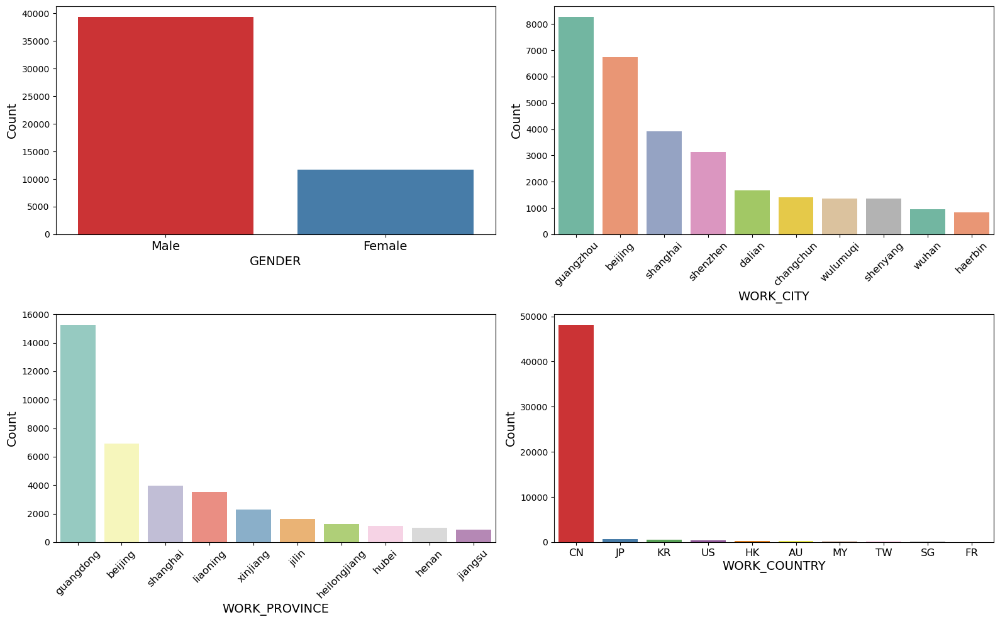

In [11]:
import warnings
warnings.filterwarnings('ignore', category=FutureWarning)



fig, ax = plt.subplots(nrows=2,ncols=2,figsize=(16,10))

# Countplot for gender
sns.countplot(x='GENDER',data=df_clean,ax=ax[0,0], palette='Set1')
ax[0,0].tick_params(axis='x',labelsize=14)
ax[0,0].set_xlabel('GENDER',fontsize=14)
ax[0,0].set_ylabel('Count',fontsize=14)

# Barplot for work_city
work_city_top10 = df_clean['WORK_CITY'].value_counts().head(10)
sns.barplot(x=work_city_top10.index,y=work_city_top10.values,ax=ax[0,1], palette='Set2')
ax[0,1].tick_params(axis='x', labelrotation= 45,labelsize=12)
ax[0,1].set_xlabel('WORK_CITY',fontsize=14)
ax[0,1].set_ylabel('Count',fontsize=14)

# Barplot for work_province
work_province_top10 = df_clean['WORK_PROVINCE'].value_counts().head(10)
sns.barplot(x=work_province_top10.index,y=work_province_top10.values,ax=ax[1,0], palette='Set3')
ax[1,0].tick_params(axis='x', labelrotation= 45,labelsize=12)
ax[1,0].set_xlabel('WORK_PROVINCE',fontsize=14)
ax[1,0].set_ylabel('Count',fontsize=14)

# Barplot for work_country
work_country_top10 = df_clean['WORK_COUNTRY'].value_counts().head(10)
sns.barplot(x=work_country_top10.index,y=work_country_top10.values,ax=ax[1,1], palette='Set1')
ax[1,1].tick_params(axis='x', labelsize=12)
ax[1,1].set_xlabel('WORK_COUNTRY',fontsize=14)
ax[1,1].set_ylabel('Count',fontsize=14)

plt.tight_layout()


In [12]:
ffp_date = pd.to_datetime(df_clean['FFP_DATE'])
ffp_date_year = ffp_date.dt.year
ffp_date_month = ffp_date.dt.month

Text(0.5, 0, 'FFP Date Month')

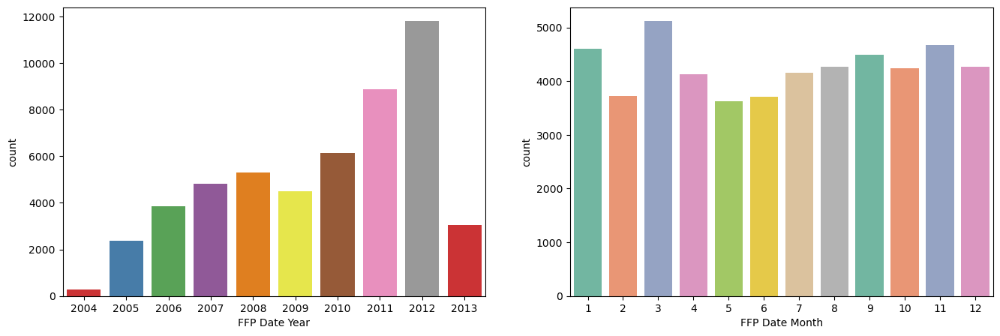

In [13]:
plt.figure(figsize=(16,5))

# Countplot for year
plt.subplot(1,2,1)
sns.countplot(x=ffp_date_year, palette='Set1')
plt.xlabel('FFP Date Year')

plt.subplot(1,2,2)
sns.countplot(x=ffp_date_month, palette='Set2')
plt.xlabel('FFP Date Month')


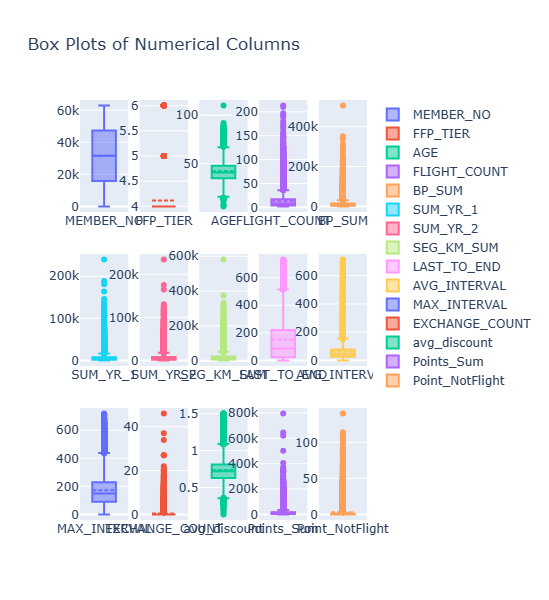

In [14]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

df_num = df_clean.select_dtypes(['int64','float64'])

# Create subplots: 3 rows, 5 cols
fig = make_subplots(rows=3, cols=5)

for i, col in enumerate(df_num.columns):
    # Create a box plot for each column
    fig.add_trace(
        go.Box(y=df_num[col], name=col, boxmean=True, boxpoints='outliers'),
        row=i//5+1, col=i%5+1
    )

fig.update_layout(height=600, width=1000, title_text="Box Plots of Numerical Columns")
fig.show()


In [15]:
df_clean.head()

,MEMBER_NO,FFP_DATE,FIRST_FLIGHT_DATE,GENDER,FFP_TIER,WORK_CITY,WORK_PROVINCE,WORK_COUNTRY,AGE,LOAD_TIME,...,SUM_YR_2,SEG_KM_SUM,LAST_FLIGHT_DATE,LAST_TO_END,AVG_INTERVAL,MAX_INTERVAL,EXCHANGE_COUNT,avg_discount,Points_Sum,Point_NotFlight
0,54993,11/2/2006,12/24/2008,Male,6,.,beijing,CN,31.0,3/31/2014,...,234188.0,580717,3/31/2014,1,3.483254,18,34,0.961639,619760,50
2,55106,2/1/2007,8/30/2007,Male,6,.,beijing,CN,40.0,3/31/2014,...,164982.0,283712,3/21/2014,11,5.298507,18,20,1.254676,406361,26
3,21189,8/22/2008,8/23/2008,Male,5,Los Angeles,CA,US,64.0,3/31/2014,...,125500.0,281336,12/26/2013,97,27.863636,73,11,1.090870,372204,12
4,39546,4/10/2009,4/15/2009,Male,6,guiyang,guizhou,CN,48.0,3/31/2014,...,130702.0,309928,3/27/2014,5,4.788079,47,27,0.970658,338813,39
5,56972,2/10/2008,9/29/2009,Male,6,guangzhou,guangdong,CN,64.0,3/31/2014,...,76946.0,294585,1/13/2014,79,7.043956,52,10,0.967692,343121,15


In [16]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
selected_features = df_clean[['SEG_KM_SUM', 'FLIGHT_COUNT', 'avg_discount', 'Points_Sum', 'Point_NotFlight']]
k = 5
kmeans = KMeans(n_clusters=k, random_state=42)
kmeans.fit(selected_features)
df_clean['Cluster'] = kmeans.labels_
segment_counts = df_clean['Cluster'].value_counts()
print("Segment Counts:")
print(segment_counts)

Segment Counts:
0    31925
3    12852
1     4739
2     1310
4      192
Name: Cluster, dtype: int64


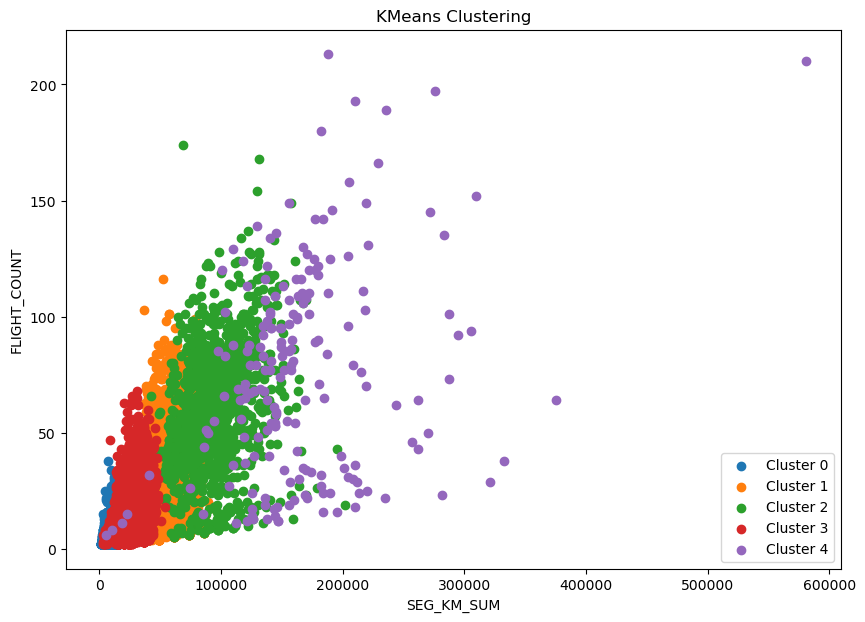

In [17]:
import matplotlib.pyplot as plt

# Create a scatter plot
plt.figure(figsize=(10, 7))

# For each cluster
for i in range(k):
    # Select just the data for this cluster
    cluster_data = df_clean[df_clean['Cluster'] == i]
    
    # Plot this cluster's data points
    plt.scatter(cluster_data['SEG_KM_SUM'], cluster_data['FLIGHT_COUNT'], label=f'Cluster {i}')

# Add labels and title
plt.xlabel('SEG_KM_SUM')
plt.ylabel('FLIGHT_COUNT')
plt.title('KMeans Clustering')
plt.legend()

# Show the plot
plt.show()


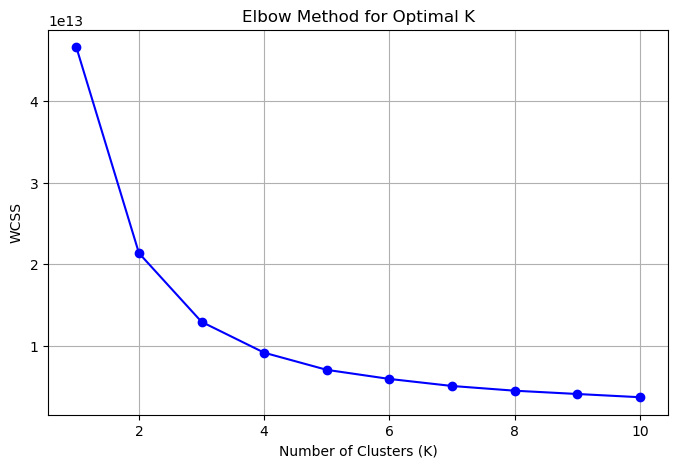

In [18]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

# Load your  data
# data = pd.read_csv('your_data.csv')

# Select relevant features for segmentation
selected_features = df[['SEG_KM_SUM', 'FLIGHT_COUNT', 'avg_discount', 'Points_Sum', 'Point_NotFlight']]



# Initialize a list to store the WCSS values for different K
wcss = []

# Try different values of K (e.g., from 1 to 10)
for k in range(1, 11):
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(selected_features)
    wcss.append(kmeans.inertia_)  # Inertia is the WCSS value


plt.figure(figsize=(8, 5))
plt.plot(range(1, 11), wcss, marker='o', linestyle='-', color='b')
plt.xlabel('Number of Clusters (K)')
plt.ylabel('WCSS')
plt.title('Elbow Method for Optimal K')
plt.grid(True)
plt.show()


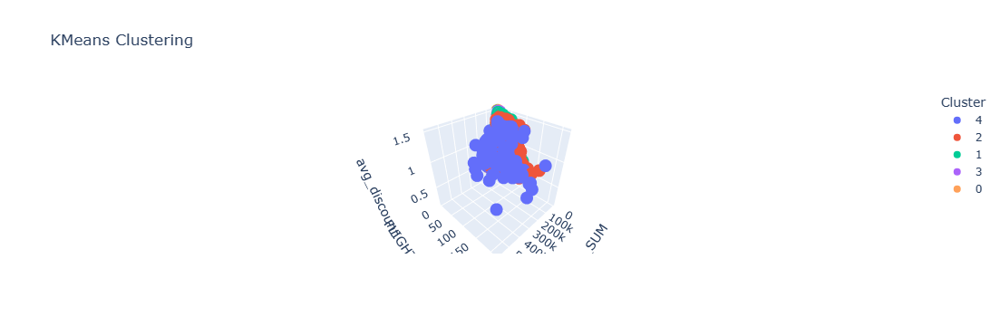

In [19]:
import plotly.express as px

# Convert cluster labels to string type for better color coding in plotly
df_clean['Cluster'] = df_clean['Cluster'].astype(str)

# Create an interactive 3D scatter plot with plotly
fig = px.scatter_3d(df_clean, x='SEG_KM_SUM', y='FLIGHT_COUNT', z='avg_discount', color='Cluster',
                    title='KMeans Clustering', hover_data=['SEG_KM_SUM', 'FLIGHT_COUNT', 'avg_discount'])

# Show the plot
fig.show()
